In [2]:
%matplotlib notebook

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl

import time
import pickle

import memory_profiler

%load_ext memory_profiler

from pathlib import Path

In [4]:
import nltk
from nltk.stem import WordNetLemmatizer
from nltk.corpus import wordnet
from nltk import pos_tag, word_tokenize

# Download necessary NLTK data
nltk.download("averaged_perceptron_tagger")
nltk.download("wordnet")
nltk.download("punkt")

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /Users/sdoneva/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package wordnet to /Users/sdoneva/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt to /Users/sdoneva/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [5]:
import black
import jupyter_black

jupyter_black.load(line_length=79)

In [6]:
%load_ext autoreload
%autoreload 2

import src
from src.plotting import (
    automatic_coloring,
    improved_coloring,
    years_coloring,
    plot_tsne_colors,
    plot_label_tags,
    plot_tsne_years,
)

In [7]:
variables_path = Path("./data/variables")
figures_path = Path("./viz/embeddings")
embeddings_data_path = Path("data/embeddings/")

In [8]:
plt.style.use("matplotlib_style.txt")

# Colors

## Import data

In [157]:
df = pd.read_csv(
    "data/annotated_aact/snomed_linking_outputs/combined_union_annotations_with_details_18609_using_cdist_filter.csv"
)

In [159]:
df.head()

,Unnamed: 0,nct_id,combined_union_snomed_term_canonical_interventions,combined_union_top_concept_canonical_first_conditions,brief_title,start_date,study_official_title,brief_summary_description,phase,overall_status,start_year
0,89,NCT00000307,Naltrexone (substance),Disorder caused by alcohol (disorder)|Disorder...,Naltrexone as Adjunct in Alcoholic Cocaine Dep...,2003-04-30,Naltrexone as an Adjunct in Alcoholic Cocaine ...,The purpose of this study is to evaluate naltr...,Phase 2,Completed,2003.0
1,106,NCT00000333,Atropine (substance)|Benzatropine (substance)|...,Cocaine|Disorder caused by cocaine (disorder),Evaluation of Benztropine for Cocaine Craving - 2,2001-05-31,Evaluation of Efficacy of Benztropine for Coca...,The purpose of this study is to compare the ef...,Phase 2,Completed,2001.0
2,145,NCT00000428,Amitriptyline (substance)|Fluoxetine (substanc...,Fibromyalgia (disorder)|Pain (finding),Combining N-of-1 Trials to Assess Fibromyalgia...,2000-09-30,Combining N-of-1 Trials to Assess Fibromyalgia...,This study will compare the effectiveness of c...,Phase 4,Completed,2000.0
3,146,NCT00000439,Sodium valproate (substance)|Valproate (substa...,Bipolar disorder (disorder)|Co-morbid conditio...,Drug Treatment for Alcoholics With Bipolar Dis...,2000-10-31,Efficacy of Valproate Maintenance in Bipolar A...,The purpose of this study is to test the effec...,Phase 2,Completed,2000.0
4,220,NCT00001956,Ketorolac (substance)|Lidocaine (substance)|Mi...,Hyperalgesia (finding)|Pain (finding)|Removal ...,Influence of Genetics in Pain Sensitivity,2000-01-31,NaN,The purpose of this study is to learn more abo...,Phase 2,Completed,2000.0


In [161]:
df[df["nct_id"] == "NCT05166161"]

,Unnamed: 0,nct_id,combined_union_snomed_term_canonical_interventions,combined_union_top_concept_canonical_first_conditions,brief_title,start_date,study_official_title,brief_summary_description,phase,overall_status,start_year
16719,17395,NCT05166161,Sepiapterin (substance)|ptc923,Hyperphenylalaninemia (disorder)|Phenylketonur...,A Long-Term Safety Study of PTC923 in Particip...,2022-02-14,A Phase 3 Open-Label Study of PTC923 (Sepiapte...,The main purpose of this study is to evaluate ...,Phase 3,Recruiting,2022.0


In [162]:
intervention_col = "combined_union_snomed_term_canonical_interventions"
conditions_col = "combined_union_top_concept_canonical_first_conditions"

In [164]:
df["trial_title_summary"] = (
    df["brief_title"].fillna("")
    + " | "
    + df["study_official_title"].fillna("")
    + " | "
    + df["brief_summary_description"].fillna("")
    + " | "
    + df[intervention_col].fillna("")
)

In [166]:
df.shape

(18609, 12)

In [169]:
df[
    df["combined_union_top_concept_canonical_first_conditions"].str.contains(
        "Tobacco user", case=False
    )
]

,Unnamed: 0,nct_id,combined_union_snomed_term_canonical_interventions,combined_union_top_concept_canonical_first_conditions,brief_title,start_date,study_official_title,brief_summary_description,phase,overall_status,start_year,trial_title_summary
20,334,NCT00006170,Bupropion (substance),Tobacco|Tobacco user (finding),Bupropion and Weight Control for Smoking Cessa...,2000-09-30,Bupropion and Weight Control for Smoking Cessa...,The purpose of this study is to determine whet...,Phase 4,Completed,2000.0,Bupropion and Weight Control for Smoking Cessa...
201,581,NCT00046813,Nicotine (substance)|nicotine patch,Psychotic disorder (disorder)|Schizoaffective ...,Nicotine Patch for Nicotine Dependence in Indi...,2001-08-31,High-Dose Versus Regular-Dose Nicotine Patch f...,The purpose of this study is to test the use o...,Phase 4,Terminated,2001.0,Nicotine Patch for Nicotine Dependence in Indi...
276,663,NCT00063323,Bupropion (substance),Tobacco user (finding),Maintenance Treatment for Abstinent Smokers,2000-08-31,Maintenance Treatment for Prevention of Smokin...,The purpose of this study is to determine the ...,Phase 3,Completed,2000.0,Maintenance Treatment for Abstinent Smokers | ...
288,678,NCT00067158,nicotine transdermal system,Cigarette smoking|Substance-related disorders|...,Smoking Cessation Treatment With Transdermal N...,2003-04-30,Smoking Cessation Treatment With Transdermal N...,The purpose of this study is to look at how fe...,Phase 3,Completed,2003.0,Smoking Cessation Treatment With Transdermal N...
396,792,NCT00086385,"nicotine polacrilex, bupropion",Tobacco user (finding),Maintaining Nonsmoking: Older Smokers - 1,2001-09-30,Maintaining Nonsmoking: Older Smokers,The purpose of this study was to examine pharm...,Phase 3,Completed,2001.0,Maintaining Nonsmoking: Older Smokers - 1 | Ma...
...,...,...,...,...,...,...,...,...,...,...,...,...
18212,18972,NCT05947162,Orexin (substance),Nicotine|Tobacco user (finding)|nicotine addicts,Effect of Orexin System on Nicotine Addiction ...,2023-11-01,Effect of Orexin System on Nicotine Addiction ...,The goal of this clinical trial is to reveal t...,Not Applicable,Not yet recruiting,2023.0,Effect of Orexin System on Nicotine Addiction ...
18340,19124,NCT06027723,Nicotine (substance),Nicotine|Nicotine dependence (disorder)|Tobacc...,Nicotine and Pavlovian Bias,2023-10-25,Effects of Acute Nicotine Administration on Mo...,Nicotine remains a major cause of health probl...,Early Phase 1,Recruiting,2023.0,Nicotine and Pavlovian Bias | Effects of Acute...
18375,19168,NCT06053567,nicotine patch,Nicotine dependence (disorder)|Tobacco user (f...,Community-based Smoking Cessation Treatment fo...,2023-12-27,Efficacy and Implementation of Exercise-based ...,"Anxiety sensitivity, reflecting the fear of bo...",Phase 3,Recruiting,2023.0,Community-based Smoking Cessation Treatment fo...
18447,19258,NCT06091826,nfl-101,Nicotine dependence (disorder)|Tobacco user (f...,Study Assessing Efficacy and Safety of NFL-101...,2023-02-21,Phase II Study Assessing Efficacy and Safety o...,"PRECESTO is a randomized, double-blind, cross-...",Phase 2,Completed,2023.0,Study Assessing Efficacy and Safety of NFL-101...


In [171]:
df_conditions_manual_review = pd.read_csv(
    "analysis/trials_trends/conditions_nr_trials_analysed.csv"
)
lookup_dict = (
    df_conditions_manual_review.dropna(subset=["Aggregate_category"])
    .set_index("Neurological Condition")["Aggregate_category"]
    .to_dict()
)


# Function to replace conditions based on the dictionary
def replace_conditions(conditions, replacement_dict):
    conditions_list = conditions.split("|")
    replaced_conditions = [
        replacement_dict.get(cond.split(" (")[0], cond)
        for cond in conditions_list
    ]
    return "|".join(replaced_conditions)


# Apply the function to the DataFrame
df["combined_union_top_concept_canonical_first_conditions"] = df[
    "combined_union_top_concept_canonical_first_conditions"
].apply(replace_conditions, replacement_dict=lookup_dict)

In [173]:
df[
    df["combined_union_top_concept_canonical_first_conditions"].str.contains(
        "Depressive conditions", case=False
    )
]

,Unnamed: 0,nct_id,combined_union_snomed_term_canonical_interventions,combined_union_top_concept_canonical_first_conditions,brief_title,start_date,study_official_title,brief_summary_description,phase,overall_status,start_year,trial_title_summary
8,287,NCT00004554,Naltrexone (substance)|Sertraline (substance),Depressive conditions|Disorder caused by alcoh...,Sertraline for Alcohol Dependence and Depression,2000-01-31,Sertraline for Alcohol Dependence and Depression,This study will examine depressed alcoholic ou...,Phase 4,Completed,2000.0,Sertraline for Alcohol Dependence and Depressi...
14,327,NCT00005850,Cisplatin (substance)|Fluoxetine (substance)|G...,Anxiety|Anxiety|Chemotherapy (procedure)|Depre...,Combination Chemotherapy Plus Fluoxetine in Tr...,2001-08-31,Fluoxetine in Stage IIIB/IV Non-Small Cell Lun...,This trial is designed to test the efficacy of...,Phase 2,Completed,2001.0,Combination Chemotherapy Plus Fluoxetine in Tr...
19,333,NCT00006077,Levodopa (substance)|levodopa and domperidone|...,Bradykinesia (finding)|Depressive conditions|M...,Effects of Monoamine Reuptake Inhibitor NS2330...,2000-08-31,Effects of Monoamine Reuptake Inhibitor NS2330...,This study will evaluate the effects of an exp...,Phase 2,Completed,2000.0,Effects of Monoamine Reuptake Inhibitor NS2330...
21,335,NCT00006180,Alendronate (substance)|Alendronic acid (subst...,Depressive conditions|Osteopenia (disorder)|Os...,Bone Loss in Premenopausal Women With Depression,2000-08-10,"The P.O.W.E.R. STUDY (Premenopause, Osteopenia...",The purpose of this study is to determine whet...,Phase 4,Completed,2000.0,Bone Loss in Premenopausal Women With Depressi...
22,338,NCT00006204,Fluoxetine (substance)|Naltrexone (substance)|...,Depressive conditions|Finding relating to alco...,Drug Treatment for Depressed Alcoholics (Naltr...,2000-03-31,Combined Pharmacotherapy in Depressed Alcoholics,This study will examine the effects of combing...,Phase 4,Completed,2000.0,Drug Treatment for Depressed Alcoholics (Naltr...
...,...,...,...,...,...,...,...,...,...,...,...,...
18537,19418,NCT06187090,oral ultramicronized-palmitoylethanolamide (um...,Anxiety|Depressive conditions|Developmental me...,The Supplementation Therapy in Autism and Resp...,2023-09-01,The Supplementation Therapy in Autism and Resp...,"In addition to the ""core"" symptoms of ASD (i.e...",Not Applicable,Recruiting,2023.0,The Supplementation Therapy in Autism and Resp...
18553,19453,NCT06207760,Minocycline (substance),Depressive conditions|Inflammatory disorder (d...,Effect of Minocycline on Inflammation in Depre...,2023-08-28,Targeting Inflammation in Depression Using Min...,The study aims to evaluate or to assess:\n\nAn...,Phase 2,Recruiting,2023.0,Effect of Minocycline on Inflammation in Depre...
18582,19527,NCT06242535,Lipoic acid (substance)|Nicotinamide (substanc...,Depressive conditions|Obese (finding),Pilot Study of GLY-LOW Supplementation in Post...,2023-07-27,Pilot Study of GLY-LOW Supplementation in Post...,A combination of generally regarded as safe (G...,Early Phase 1,Recruiting,2023.0,Pilot Study of GLY-LOW Supplementation in Post...
18593,19562,NCT06259526,active drug group|js1-1-01|js1-1-01 high-dose ...,Depressive conditions,A Study of the Effectiveness and Safety of JS1...,2023-12-26,"A Phase 2, Multi-Center, Randomized, Double-Bl...",The purpose of this study is to evaluate the E...,Phase 2,Recruiting,2023.0,A Study of the Effectiveness and Safety of JS1...


### load tsne

In [176]:
tsne_reparsed = np.load(variables_path / "tsne_reparsed.npy")
tsne = np.vstack((-tsne_reparsed[:, 0], tsne_reparsed[:, 1])).T

In [178]:
tsne.shape

(18609, 2)

## Preprocess

In [181]:
# Function to lemmatize a sentence
def lemmatize_sentence(sentence):
    lemmatizer = WordNetLemmatizer()
    # Tokenize the sentence
    tokens = word_tokenize(sentence)
    # Lemmatize each token with its correct POS tag
    lemmatized_tokens = [lemmatizer.lemmatize(token) for token in tokens]
    # Combine the lemmatized tokens back into a single string
    return " ".join(lemmatized_tokens)

In [183]:
# df["lemmatized_trial_title_summary"] = df["trial_title_summary"].apply(
#    lambda x: lemmatize_sentence(x)
# )

In [185]:
df.head()

,Unnamed: 0,nct_id,combined_union_snomed_term_canonical_interventions,combined_union_top_concept_canonical_first_conditions,brief_title,start_date,study_official_title,brief_summary_description,phase,overall_status,start_year,trial_title_summary
0,89,NCT00000307,Naltrexone (substance),Disorder caused by alcohol (disorder)|Disorder...,Naltrexone as Adjunct in Alcoholic Cocaine Dep...,2003-04-30,Naltrexone as an Adjunct in Alcoholic Cocaine ...,The purpose of this study is to evaluate naltr...,Phase 2,Completed,2003.0,Naltrexone as Adjunct in Alcoholic Cocaine Dep...
1,106,NCT00000333,Atropine (substance)|Benzatropine (substance)|...,Cocaine|Disorder caused by cocaine (disorder),Evaluation of Benztropine for Cocaine Craving - 2,2001-05-31,Evaluation of Efficacy of Benztropine for Coca...,The purpose of this study is to compare the ef...,Phase 2,Completed,2001.0,Evaluation of Benztropine for Cocaine Craving ...
2,145,NCT00000428,Amitriptyline (substance)|Fluoxetine (substanc...,Fibromyalgia (disorder)|Pain (finding),Combining N-of-1 Trials to Assess Fibromyalgia...,2000-09-30,Combining N-of-1 Trials to Assess Fibromyalgia...,This study will compare the effectiveness of c...,Phase 4,Completed,2000.0,Combining N-of-1 Trials to Assess Fibromyalgia...
3,146,NCT00000439,Sodium valproate (substance)|Valproate (substa...,Bipolar disorder (disorder)|Co-morbid conditio...,Drug Treatment for Alcoholics With Bipolar Dis...,2000-10-31,Efficacy of Valproate Maintenance in Bipolar A...,The purpose of this study is to test the effec...,Phase 2,Completed,2000.0,Drug Treatment for Alcoholics With Bipolar Dis...
4,220,NCT00001956,Ketorolac (substance)|Lidocaine (substance)|Mi...,Hyperalgesia (finding)|Pain (finding)|Removal ...,Influence of Genetics in Pain Sensitivity,2000-01-31,NaN,The purpose of this study is to learn more abo...,Phase 2,Completed,2000.0,Influence of Genetics in Pain Sensitivity | |...


In [187]:
# df.to_csv("df_with_lemma.csv")

## Colors based on keywords

### Conditions

In [191]:
"""
Description of colors and words below.

Colors:
-chosen_colors: colors chosen manually from Scanpy colors selection 
(originally from http://godsnotwheregodsnot.blogspot.com/2013/11/kmeans-color-quantization-seeding.html)

Words:
-words_capital: Words selected manually from the 100 most relevant words using threshold 0.1.
"""

# COLORS
chosen_colors = [
    "black",
    "#aeaa00",
    "#1CE6FF",
    "#FF34FF",
    "#FF4A46",
    "#008941",
    "#006FA6",
    "#0089A3",
    "#0000A6",
    "#B79762",
    "#004D43",
    "#8FB0FF",
    "#5A0007",
    "#BA0900",
    "#1B4400",
    "#4FC601",
    "#3B5DFF",
    "#00C2A0",
    "#549E79",
    "#BC23FF",
    "#C895C5",
    "#FF2F80",
    "#009271",
    "#00FECF",
    "#A4E804",
    "#FFB500",
    "#6B002C",
    "#FF9408",
    "#CC0744",
    "#D790FF",
    "#5B4534",
    "#E83000",
    "#6F0062",
    "#b65141",
    "#C20078",
    "#7A4900",
    "#FF90C9",
    "#6508ba",
]
# WORDS
words = [
    "dystrophy",
    "cocaine",
    "stroke",
    "delirium",
    "cancer",
    "sleep",
    "tumor",
    "opioid",
    "ataxia",
    "pharmacokinetic",
    "fibromyalgia",
    "fabry disease",
    "dementia",
    "withdrawal",
    "tourette",
    "autism",
    "vaccine",
    "dependence",
    "spinal",
    "erectile dysfunction",
    "seizures",
    "lateral sclerosis",
    "diabetes",
    "smoking",
    "anxiety",
    "epilepsy",
    "OCD",
    "migraine",
    "stress",
    "neonatal",
    "bipolar",
    "hemorrhage",
    "multiple sclerosis",
    "depression",
    "alzheimer",
    "pain",
    "parkinson",
    "schizophrenia",
]

In [193]:
nsc_words = [
    "plasticity",
    "visual",
    "auditory",
    "parkinson",
    "learning",
    "memory",
    "sleep",
    "depression",
    "cognitive",
    "olfactory",
    "alzheimer",
    "social",
    "pain",
    "attention",
    "prefrontal",
    "temporal",
    "schizophrenia",
    "retina",
    "stress",
    "sensory",
    "cerebellar",
    "hippocampus",
    "motor",
    "perception",
    "age",
    "behavioral",
    "stroke",
    "epilepsy",
    "reward",
    "imaging",
    "fear",
    "astrocytes",
    "sclerosis",
    "dependence",
    "migraine",
    "tumor",
    "bipolar",
    "pharmacokinetic",
]

In [195]:
top_30_disease_names = [
    "Depressive conditions",
    "Schizophrenia",
    "Alzheimer's disease",
    "Parkinsonism",
    "Neoplastic disease",
    "Anxiety disorder",
    "Multiple sclerosis",
    "Seizure disorder",
    "Impaired cognition",
    "Pain",
    "Cerebrovascular accident",
    "Headache disorder",
    "Infectious disease",
    "Congenital malformation",
    "Bipolar disorder",
    "Sleep disorder",
    "Psychotic disorder",
    "Spinal cord disorder",
    "Psychoactive substance abuse",
    "Infectious disease",
    "Sexual disorder",
    "Neoplasm of nervous system",
    "Developmental mental disorder",
    "Motor neuron disease",
    "Peripheral nerve disease",
    "Traumatic brain injury",
    "Confusional state",
    "Schizoaffective disorder",
    "Cranial neuralgia",
    "Bodily distress disorder",
    "Disorder caused by cocaine",
]

In [197]:
top_30_disease_names = [
    "Pain",
    "Schizophrenia",
    "Depressive conditions",
    "Impaired cognition",
    "Alzheimer's disease",
    "Parkinsonism",
    "Disorder caused by cocaine",
    "Multiple sclerosis",
    "Cerebrovascular conditions",
    "Anxiety",
    "Motor disorders",
    "Neoplastic disorders",
    "Seizure",
    "Bipolar disorder",
    "Sleep disorder",
    "Headache disorder",
    "Psychotic disorder",
    "Spinal cord disorder",
    "Tobacco user",
    "Hereditary metabolic disease",
    "Infectious disease",
    "Surgical procedure",
    "Neuralgia",
    "Congenital malformation",
    "Developmental mental disorder",
    "Schizoaffective disorder",
    "Traumatic brain injury",
    "Erectile dysfunction",
    "No sensitivity to pain",
    "Pervasive developmental disorder",
]

len(top_30_disease_names)

30

In [199]:
len(nsc_words), len(words)

(38, 38)

In [201]:
df["trial_title_summary"] = df["trial_title_summary"].str.replace(
    r"\bsmoker(s)?\b", "smoking", case=False, regex=True
)
df["trial_title_summary"] = df["trial_title_summary"].str.replace(
    r"\bdepressive\b", "depression", case=False, regex=True
)
df["trial_title_summary"] = df["trial_title_summary"].str.replace(
    r"\bopiate\b", "opioid", case=False, regex=True
)
df["trial_title_summary"] = df["trial_title_summary"].str.replace(
    r"\binsomnia\b", "sleep disorder", case=False, regex=True
)
df["trial_title_summary"] = df["trial_title_summary"].str.replace(
    r"\bschizophrenic\b", "schizophrenia", case=False, regex=True
)
df["trial_title_summary"] = df["trial_title_summary"].str.replace(
    r"\bvaccines\b", "vaccine", case=False, regex=True
)

In [202]:
len(chosen_colors), len(words)

(38, 38)

In [203]:
colors_new_legend = dict(zip(top_30_disease_names, chosen_colors))
len(colors_new_legend)

30

#### assign cluster

In [208]:
df.head()

,Unnamed: 0,nct_id,combined_union_snomed_term_canonical_interventions,combined_union_top_concept_canonical_first_conditions,brief_title,start_date,study_official_title,brief_summary_description,phase,overall_status,start_year,trial_title_summary
0,89,NCT00000307,Naltrexone (substance),Disorder caused by alcohol (disorder)|Disorder...,Naltrexone as Adjunct in Alcoholic Cocaine Dep...,2003-04-30,Naltrexone as an Adjunct in Alcoholic Cocaine ...,The purpose of this study is to evaluate naltr...,Phase 2,Completed,2003.0,Naltrexone as Adjunct in Alcoholic Cocaine Dep...
1,106,NCT00000333,Atropine (substance)|Benzatropine (substance)|...,Cocaine|Disorder caused by cocaine (disorder),Evaluation of Benztropine for Cocaine Craving - 2,2001-05-31,Evaluation of Efficacy of Benztropine for Coca...,The purpose of this study is to compare the ef...,Phase 2,Completed,2001.0,Evaluation of Benztropine for Cocaine Craving ...
2,145,NCT00000428,Amitriptyline (substance)|Fluoxetine (substanc...,Fibromyalgia (disorder)|Pain (finding),Combining N-of-1 Trials to Assess Fibromyalgia...,2000-09-30,Combining N-of-1 Trials to Assess Fibromyalgia...,This study will compare the effectiveness of c...,Phase 4,Completed,2000.0,Combining N-of-1 Trials to Assess Fibromyalgia...
3,146,NCT00000439,Sodium valproate (substance)|Valproate (substa...,Bipolar disorder (disorder)|Co-morbid conditio...,Drug Treatment for Alcoholics With Bipolar Dis...,2000-10-31,Efficacy of Valproate Maintenance in Bipolar A...,The purpose of this study is to test the effec...,Phase 2,Completed,2000.0,Drug Treatment for Alcoholics With Bipolar Dis...
4,220,NCT00001956,Ketorolac (substance)|Lidocaine (substance)|Mi...,Hyperalgesia (finding)|Pain (finding)|Removal ...,Influence of Genetics in Pain Sensitivity,2000-01-31,NaN,The purpose of this study is to learn more abo...,Phase 2,Completed,2000.0,Influence of Genetics in Pain Sensitivity | |...


In [210]:
%%time
labels_new, colors_new = improved_coloring(
    df["combined_union_top_concept_canonical_first_conditions"],
    colors_new_legend,
)

df["cluster"] = labels_new

CPU times: user 296 ms, sys: 8.86 ms, total: 304 ms
Wall time: 323 ms


In [211]:
cluster_sizes = df["cluster"].value_counts()

# Optionally, to convert it back to a DataFrame for better visualization or further processing:
cluster_sizes_df = cluster_sizes.reset_index().rename(
    columns={"index": "Cluster", "cluster": "Size"}
)

print(cluster_sizes_df)

                                Size  count
0                          unlabeled   3431
1                Alzheimer's disease   1151
2                      Schizophrenia    896
3                       Parkinsonism    871
4                 Multiple sclerosis    813
5                    Motor disorders    752
6         Cerebrovascular conditions    723
7              Depressive conditions    719
8                 Infectious disease    684
9                            Seizure    662
10                           Anxiety    628
11                 Headache disorder    615
12              Neoplastic disorders    607
13                    Sleep disorder    584
14                  Bipolar disorder    555
15                              Pain    501
16                      Tobacco user    431
17              Spinal cord disorder    394
18                         Neuralgia    361
19           Congenital malformation    357
20          Schizoaffective disorder    337
21                Surgical proce

In [214]:
df_no_cluster = df[df["cluster"] == "unlabeled"]
df_no_cluster.shape

(3431, 13)

In [216]:
counts = df_no_cluster[conditions_col].value_counts()
counts = counts.sort_values(ascending=False).head(30)

In [218]:
counts

combined_union_top_concept_canonical_first_conditions
Acromegaly (disorder)                                                                                                        48
Dystonia (disorder)                                                                                                          47
Obsessive-compulsive disorder (disorder)                                                                                     46
Sarcopenia (disorder)                                                                                                        45
Tic (finding)                                                                                                                42
Degenerative disorder of muscle (disorder)|Sarcopenia (disorder)                                                             36
Hyperphenylalaninemia (disorder)|Phenylketonuria (disorder)                                                                  32
Meningitis (disorder)                             

In [220]:
df_no_cluster.to_csv("missing_cluster_nsc_words.csv")

In [222]:
len(labels_new)

18609

In [224]:
# save results
np.save(variables_path / "colors_new", colors_new)

# save results
f = open(variables_path / "colors_new_legend.pkl", "wb")
pickle.dump(colors_new_legend, f)
f.close()

#### Plot

In [227]:
tsne

array([[ -21.18816944, -103.92691703],
       [ -20.67828479, -107.76614901],
       [  28.74919631,    6.97977126],
       ...,
       [ 102.47873762,  -38.68232043],
       [ -51.45323918,   -5.53557193],
       [ 106.6287184 ,  -18.45985532]])

In [229]:
# load
# legend colors
pickle_in = open(variables_path / "colors_new_legend.pkl", "rb")
colors_new_legend = pickle.load(pickle_in)

colors_new = np.load(variables_path / "colors_new.npy", allow_pickle=True)

In [231]:
len(colors_new)

18609

In [233]:
len(tsne)

18609

In [235]:
len(colors_new_legend)

30

In [237]:
colors_new_legend

{'Pain': 'black',
 'Schizophrenia': '#aeaa00',
 'Depressive conditions': '#1CE6FF',
 'Impaired cognition': '#FF34FF',
 "Alzheimer's disease": '#FF4A46',
 'Parkinsonism': '#008941',
 'Disorder caused by cocaine': '#006FA6',
 'Multiple sclerosis': '#0089A3',
 'Cerebrovascular conditions': '#0000A6',
 'Anxiety': '#B79762',
 'Motor disorders': '#004D43',
 'Neoplastic disorders': '#8FB0FF',
 'Seizure': '#5A0007',
 'Bipolar disorder': '#BA0900',
 'Sleep disorder': '#1B4400',
 'Headache disorder': '#4FC601',
 'Psychotic disorder': '#3B5DFF',
 'Spinal cord disorder': '#00C2A0',
 'Tobacco user': '#549E79',
 'Hereditary metabolic disease': '#BC23FF',
 'Infectious disease': '#C895C5',
 'Surgical procedure': '#FF2F80',
 'Neuralgia': '#009271',
 'Congenital malformation': '#00FECF',
 'Developmental mental disorder': '#A4E804',
 'Schizoaffective disorder': '#FFB500',
 'Traumatic brain injury': '#6B002C',
 'Erectile dysfunction': '#FF9408',
 'No sensitivity to pain': '#CC0744',
 'Pervasive developmen

In [244]:
figures_path

PosixPath('viz/embeddings')

/Users/sdoneva/Documents/Work/In Progress/PhD/PhD Projects/In Progress/NeuroTrialAnalysis/src/plotting.py:442: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

/Users/sdoneva/Documents/Work/In Progress/PhD/PhD Projects/In Progress/NeuroTrialAnalysis/src/plotting.py:438: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

/Users/sdoneva/Documents/Work/In Progress/PhD/PhD Projects/In Progress/NeuroTrialAnalysis/src/plotting.py:458: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value

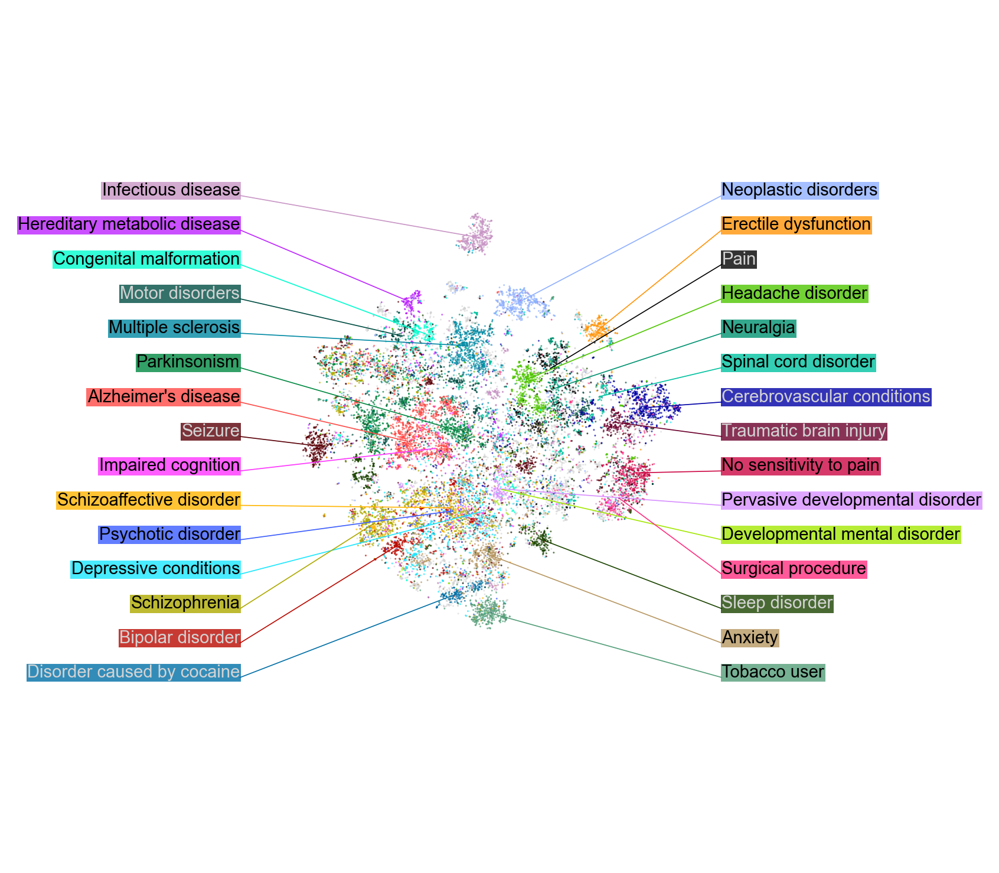

In [248]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5.5, 5), dpi=300, layout="constrained")

txtkwargs = dict(size=8, weight="bold", va="top", ha="left")
x_lim = (-160, 160)
y_lim = (-160, 160)

plot_tsne_colors(
    tsne, colors_new, x_lim=x_lim, y_lim=y_lim, ax=ax, plot_type="test"
)
plot_label_tags(
    tsne,
    colors_new,
    colors_new_legend,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    fontsize=7,
    rs=2,
    subset=False,
)
# Adjust layout after plotting
plt.tight_layout()
fig.savefig(
    figures_path
    / f"tsne_colored_by_condition_labels_{len(tsne)}_with_cdist_threshold.pdf",
    dpi=300,
)

### Interactive Plot

In [250]:
tsne.shape

(18609, 2)

In [252]:
tsne

array([[ -21.18816944, -103.92691703],
       [ -20.67828479, -107.76614901],
       [  28.74919631,    6.97977126],
       ...,
       [ 102.47873762,  -38.68232043],
       [ -51.45323918,   -5.53557193],
       [ 106.6287184 ,  -18.45985532]])

In [254]:
df.shape

(18609, 13)

In [256]:
len(colors_new)

18609

In [258]:
df_tsne = pd.DataFrame(tsne, columns=["x", "y"])
df_tsne

,x,y
0,-21.188169,-103.926917
1,-20.678285,-107.766149
2,28.749196,6.979771
3,-27.349943,-91.815447
4,26.724364,7.365954
...,...,...
18604,64.506058,30.456316
18605,0.392299,-23.148354
18606,102.478738,-38.682320
18607,-51.453239,-5.535572


In [260]:
df

,Unnamed: 0,nct_id,combined_union_snomed_term_canonical_interventions,combined_union_top_concept_canonical_first_conditions,brief_title,start_date,study_official_title,brief_summary_description,phase,overall_status,start_year,trial_title_summary,cluster
0,89,NCT00000307,Naltrexone (substance),Disorder caused by alcohol (disorder)|Disorder...,Naltrexone as Adjunct in Alcoholic Cocaine Dep...,2003-04-30,Naltrexone as an Adjunct in Alcoholic Cocaine ...,The purpose of this study is to evaluate naltr...,Phase 2,Completed,2003.0,Naltrexone as Adjunct in Alcoholic Cocaine Dep...,Disorder caused by cocaine
1,106,NCT00000333,Atropine (substance)|Benzatropine (substance)|...,Cocaine|Disorder caused by cocaine (disorder),Evaluation of Benztropine for Cocaine Craving - 2,2001-05-31,Evaluation of Efficacy of Benztropine for Coca...,The purpose of this study is to compare the ef...,Phase 2,Completed,2001.0,Evaluation of Benztropine for Cocaine Craving ...,Disorder caused by cocaine
2,145,NCT00000428,Amitriptyline (substance)|Fluoxetine (substanc...,Fibromyalgia (disorder)|Pain (finding),Combining N-of-1 Trials to Assess Fibromyalgia...,2000-09-30,Combining N-of-1 Trials to Assess Fibromyalgia...,This study will compare the effectiveness of c...,Phase 4,Completed,2000.0,Combining N-of-1 Trials to Assess Fibromyalgia...,Pain
3,146,NCT00000439,Sodium valproate (substance)|Valproate (substa...,Bipolar disorder (disorder)|Co-morbid conditio...,Drug Treatment for Alcoholics With Bipolar Dis...,2000-10-31,Efficacy of Valproate Maintenance in Bipolar A...,The purpose of this study is to test the effec...,Phase 2,Completed,2000.0,Drug Treatment for Alcoholics With Bipolar Dis...,Bipolar disorder
4,220,NCT00001956,Ketorolac (substance)|Lidocaine (substance)|Mi...,Hyperalgesia (finding)|Pain (finding)|Removal ...,Influence of Genetics in Pain Sensitivity,2000-01-31,NaN,The purpose of this study is to learn more abo...,Phase 2,Completed,2000.0,Influence of Genetics in Pain Sensitivity | |...,Surgical procedure
...,...,...,...,...,...,...,...,...,...,...,...,...,...
18604,19606,NCT06282640,Ergocalciferol (substance)|Vitamin D measureme...,Median neuropathy (disorder)|Pain (finding)|Pe...,Comparıson Of Electromyography Results Before ...,2021-12-30,Comparıson Of Electromyography Results Before ...,"Therefore, we aimed to evaluate the effectiven...",Phase 4,Completed,2021.0,Comparıson Of Electromyography Results Before ...,Pain
18605,19613,NCT06287502,2-methyl-3-hydroxybutyrate (substance),Degenerative disorder of muscle (disorder)|Ost...,Efficacy of Structured Exercise-Nutritional In...,2022-09-09,Efficacy of Structured Exercise-Nutritional In...,"This is a prospective parallel group, double-b...",Not Applicable,"Active, not recruiting",2022.0,Efficacy of Structured Exercise-Nutritional In...,unlabeled
18606,19616,NCT06289335,Dexmedetomidine (substance)|Ondansetron (subst...,Procedure on abdomen (procedure)|emergence del...,Dexmedetomidine Compared to Ondansetron for Po...,2020-08-05,Dexmedetomidine Compared With Ondansetron in T...,Evaluate the efficiency of management with int...,Phase 2,Completed,2020.0,Dexmedetomidine Compared to Ondansetron for Po...,unlabeled
18607,19623,NCT06292351,dmb-i|dmb-i (dimebon),Alzheimer's disease (disorder)|Impaired cognit...,DMB-I in the Treatment of Alzheimer Type Dementia,2023-12-27,Multicenter Randomized Double-blind Placebo-co...,The purpose of this study is to assess the eff...,Phase 2/Phase 3,Recruiting,2023.0,DMB-I in the Treatment of Alzheimer Type Demen...,Alzheimer's disease


In [261]:
df[
    [
        "nct_id",
        "brief_title",
        "phase",
        "overall_status",
        "cluster",
        "start_year",
    ]
]

,nct_id,brief_title,phase,overall_status,cluster,start_year
0,NCT00000307,Naltrexone as Adjunct in Alcoholic Cocaine Dep...,Phase 2,Completed,Disorder caused by cocaine,2003.0
1,NCT00000333,Evaluation of Benztropine for Cocaine Craving - 2,Phase 2,Completed,Disorder caused by cocaine,2001.0
2,NCT00000428,Combining N-of-1 Trials to Assess Fibromyalgia...,Phase 4,Completed,Pain,2000.0
3,NCT00000439,Drug Treatment for Alcoholics With Bipolar Dis...,Phase 2,Completed,Bipolar disorder,2000.0
4,NCT00001956,Influence of Genetics in Pain Sensitivity,Phase 2,Completed,Surgical procedure,2000.0
...,...,...,...,...,...,...
18604,NCT06282640,Comparıson Of Electromyography Results Before ...,Phase 4,Completed,Pain,2021.0
18605,NCT06287502,Efficacy of Structured Exercise-Nutritional In...,Not Applicable,"Active, not recruiting",unlabeled,2022.0
18606,NCT06289335,Dexmedetomidine Compared to Ondansetron for Po...,Phase 2,Completed,unlabeled,2020.0
18607,NCT06292351,DMB-I in the Treatment of Alzheimer Type Dementia,Phase 2/Phase 3,Recruiting,Alzheimer's disease,2023.0


#### save for interactive dashboard

In [265]:
trial_metadata_raw = pd.read_csv(
    "data/raw_aact/combined_neuro_designs_calculated_full_v2_20240701.csv"
)[
    [
        "nct_id",
        "allocation",
        "masking",
        "agency_class",
        "lead_or_collaborator",
        "sponsor_name",
    ]
].drop_duplicates()

/var/folders/nd/2fzvhsh510gbt9x6z5pdb1gr0000gn/T/ipykernel_77448/3951802153.py:1: DtypeWarning:

Columns (2,7,8,18) have mixed types. Specify dtype option on import or set low_memory=False.



In [266]:
def replace_agency_class(row):
    if (
        "university" in row["sponsor_name"].lower()
        or ("universita" in row["sponsor_name"].lower())
        or ("université" in row["sponsor_name"].lower())
        or ("universität" in row["sponsor_name"].lower())
        or ("universiteit" in row["sponsor_name"].lower())
        or ("universidad" in row["sponsor_name"].lower())
    ):
        return "UNIVERSITY"
    elif "hospital" in row["sponsor_name"].lower():
        return "HOSPITAL"
    else:
        return row["agency_class"]


trial_metadata = trial_metadata_raw[
    trial_metadata_raw["lead_or_collaborator"] == "lead"
]
trial_metadata["agency_class"] = trial_metadata.apply(
    replace_agency_class, axis=1
)

trial_metadata = trial_metadata.fillna("Not reported")

trial_metadata

/var/folders/nd/2fzvhsh510gbt9x6z5pdb1gr0000gn/T/ipykernel_77448/78819609.py:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,nct_id,allocation,masking,agency_class,lead_or_collaborator,sponsor_name
0,NCT00000117,Randomized,Double,NIH,lead,National Eye Institute (NEI)
6,NCT00000121,Randomized,Not reported,NIH,lead,National Eye Institute (NEI)
9,NCT00000127,Randomized,Not reported,NIH,lead,National Eye Institute (NEI)
12,NCT00000128,Randomized,Not reported,NIH,lead,National Eye Institute (NEI)
17,NCT00000146,Randomized,Single,NIH,lead,National Eye Institute (NEI)
...,...,...,...,...,...,...
9259650,NCT06296628,Randomized,None (Open Label),UNIVERSITY,lead,Yale University
9259659,NCT06296771,Randomized,None (Open Label),UNIVERSITY,lead,University of Bath
9259662,NCT06296784,Randomized,None (Open Label),UNIVERSITY,lead,University of Cagliari
9259670,NCT06296875,Randomized,Triple,UNIVERSITY,lead,University of Glasgow


In [267]:
df_combined_for_dashboard = pd.concat(
    [
        df[
            [
                "nct_id",
                "brief_title",
                "phase",
                "overall_status",
                "start_year",
                "cluster",
            ]
        ],
        df_tsne,
    ],
    axis=1,
)
df_combined_for_dashboard["Color"] = colors_new
df_combined_for_dashboard["start_year"] = df_combined_for_dashboard[
    "start_year"
].astype(int)

df_combined_for_dashboard = pd.merge(
    df_combined_for_dashboard, trial_metadata, on="nct_id", how="left"
)
df_combined_for_dashboard = df_combined_for_dashboard.drop(
    columns=["lead_or_collaborator"]
)

df_combined_for_dashboard

,nct_id,brief_title,phase,overall_status,start_year,cluster,x,y,Color,allocation,masking,agency_class,sponsor_name
0,NCT00000307,Naltrexone as Adjunct in Alcoholic Cocaine Dep...,Phase 2,Completed,2003,Disorder caused by cocaine,-21.188169,-103.926917,#006FA6,Not reported,Not reported,NIH,National Institute on Drug Abuse (NIDA)
1,NCT00000333,Evaluation of Benztropine for Cocaine Craving - 2,Phase 2,Completed,2001,Disorder caused by cocaine,-20.678285,-107.766149,#006FA6,Not reported,Not reported,NIH,National Institute on Drug Abuse (NIDA)
2,NCT00000428,Combining N-of-1 Trials to Assess Fibromyalgia...,Phase 4,Completed,2000,Pain,28.749196,6.979771,black,Randomized,Quadruple,OTHER,Tufts Medical Center
3,NCT00000439,Drug Treatment for Alcoholics With Bipolar Dis...,Phase 2,Completed,2000,Bipolar disorder,-27.349943,-91.815447,#BA0900,Randomized,Quadruple,NIH,National Institute on Alcohol Abuse and Alcoho...
4,NCT00001956,Influence of Genetics in Pain Sensitivity,Phase 2,Completed,2000,Surgical procedure,26.724364,7.365954,#FF2F80,Not reported,Not reported,NIH,National Institute of Dental and Craniofacial ...
...,...,...,...,...,...,...,...,...,...,...,...,...,...
18604,NCT06282640,Comparıson Of Electromyography Results Before ...,Phase 4,Completed,2021,Pain,64.506058,30.456316,black,Not reported,None (Open Label),OTHER_GOV,Dr. Ayşe Güç
18605,NCT06287502,Efficacy of Structured Exercise-Nutritional In...,Not Applicable,"Active, not recruiting",2022,unlabeled,0.392299,-23.148354,lightgrey,Randomized,Single,HOSPITAL,"Kowloon Hospital, Hong Kong"
18606,NCT06289335,Dexmedetomidine Compared to Ondansetron for Po...,Phase 2,Completed,2020,unlabeled,102.478738,-38.682320,lightgrey,Randomized,Single,HOSPITAL,"Hospital Central ""Dr. Ignacio Morones Prieto"""
18607,NCT06292351,DMB-I in the Treatment of Alzheimer Type Dementia,Phase 2/Phase 3,Recruiting,2023,Alzheimer's disease,-51.453239,-5.535572,#FF4A46,Randomized,Double,INDUSTRY,Bigespas LTD


In [268]:
df_combined_for_dashboard.to_csv("data_for_dashboard.csv")

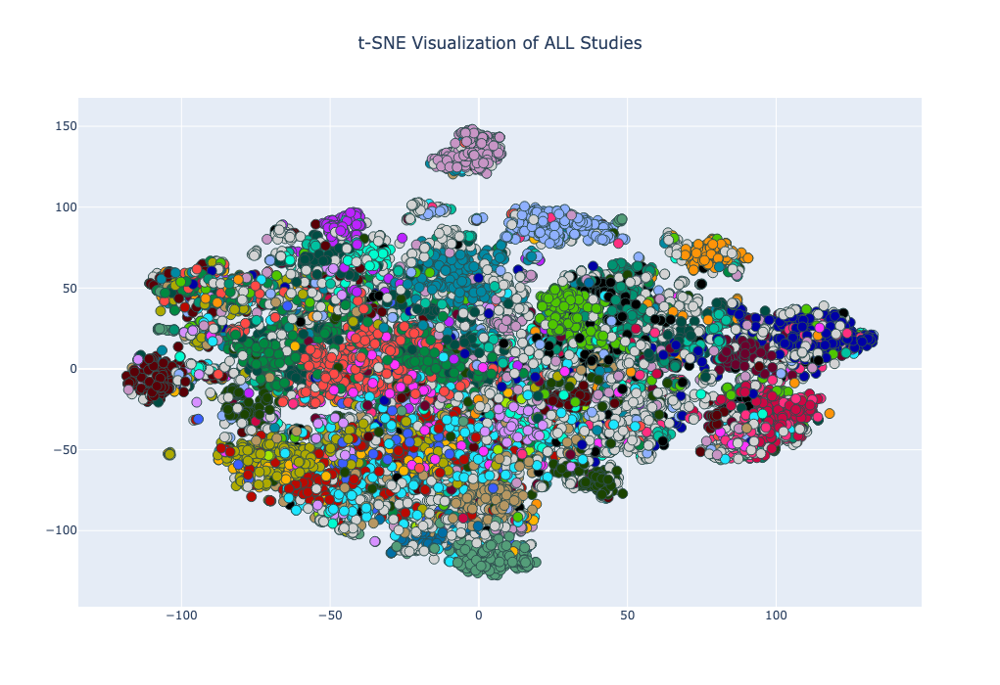

In [269]:
import plotly.graph_objects as go

# Assuming your t-SNE data is stored in a variable named `tsne`
# And your DataFrame `df` contains a column 'study_official_title' for the official titles

fig = go.Figure()

# Add scatter plot for t-SNE data points
fig.add_trace(
    go.Scatter(
        x=tsne[:, 0],  # Use your t-SNE x coordinates
        y=tsne[:, 1],  # Use your t-SNE y coordinates
        mode="markers",
        marker=dict(
            color=colors_new,  # "RoyalBlue",  # Use a single color for all points
            size=10,  # Adjust the marker size here
            line=dict(width=1, color="DarkSlateGrey"),
        ),
        text=[
            f"<b>{nctid}:</b> {title}"
            for nctid, title in zip(df["nct_id"], df["study_official_title"])
        ],  # Combine NCT ID and title for hover text
        hovertemplate="%{text}<extra></extra>",
        showlegend=False,  # Hide the legend for data points
    )
)

# Update plot size here
fig.update_layout(
    title="t-SNE Visualization of ALL Studies",
    title_x=0.5,
    width=900,  # Set the width of the plot
    height=700,  # Set the height of the plot
)
# Show the figure
fig.show()

#### inspect Parkinsonism clusters

In [271]:
df.shape

(18609, 13)

In [272]:
df["phase"] = df["phase"].replace("Early Phase 1", "Phase 1")
df["phase"] = df["phase"].replace("Phase 2/Phase 3", "Phase 2/3")
df["phase"] = df["phase"].replace("Phase 1/Phase 2", "Phase 1/2")

In [273]:
drug_col_name = "combined_union_snomed_term_canonical_interventions"
condition_col_name = "combined_union_top_concept_canonical_first_conditions"


def remove_suffixes(text, concept_type_subset):
    if isinstance(text, str):
        for suffix in concept_type_subset:
            text = text.replace(f"({suffix})", "").strip()
    return text


concept_type_subset = [
    "disorder",
    "substance",
    "finding",
    "procedure",
    "medicinal product",
]
# Apply the function to the relevant columns
df[drug_col_name] = df[drug_col_name].apply(
    lambda x: remove_suffixes(x, concept_type_subset)
)
df[condition_col_name] = df[condition_col_name].apply(
    lambda x: remove_suffixes(x, concept_type_subset)
)

In [274]:
df

,Unnamed: 0,nct_id,combined_union_snomed_term_canonical_interventions,combined_union_top_concept_canonical_first_conditions,brief_title,start_date,study_official_title,brief_summary_description,phase,overall_status,start_year,trial_title_summary,cluster
0,89,NCT00000307,Naltrexone,Disorder caused by alcohol |Disorder caused by...,Naltrexone as Adjunct in Alcoholic Cocaine Dep...,2003-04-30,Naltrexone as an Adjunct in Alcoholic Cocaine ...,The purpose of this study is to evaluate naltr...,Phase 2,Completed,2003.0,Naltrexone as Adjunct in Alcoholic Cocaine Dep...,Disorder caused by cocaine
1,106,NCT00000333,Atropine |Benzatropine |Substance with dopamin...,Cocaine|Disorder caused by cocaine,Evaluation of Benztropine for Cocaine Craving - 2,2001-05-31,Evaluation of Efficacy of Benztropine for Coca...,The purpose of this study is to compare the ef...,Phase 2,Completed,2001.0,Evaluation of Benztropine for Cocaine Craving ...,Disorder caused by cocaine
2,145,NCT00000428,Amitriptyline |Fluoxetine |amitriptyline plus ...,Fibromyalgia |Pain,Combining N-of-1 Trials to Assess Fibromyalgia...,2000-09-30,Combining N-of-1 Trials to Assess Fibromyalgia...,This study will compare the effectiveness of c...,Phase 4,Completed,2000.0,Combining N-of-1 Trials to Assess Fibromyalgia...,Pain
3,146,NCT00000439,Sodium valproate |Valproate |Valproic acid |de...,Bipolar disorder |Co-morbid conditions |Disord...,Drug Treatment for Alcoholics With Bipolar Dis...,2000-10-31,Efficacy of Valproate Maintenance in Bipolar A...,The purpose of this study is to test the effec...,Phase 2,Completed,2000.0,Drug Treatment for Alcoholics With Bipolar Dis...,Bipolar disorder
4,220,NCT00001956,Ketorolac |Lidocaine |Midazolam |Sedative,Hyperalgesia |Pain |Removal |Surgical procedure,Influence of Genetics in Pain Sensitivity,2000-01-31,NaN,The purpose of this study is to learn more abo...,Phase 2,Completed,2000.0,Influence of Genetics in Pain Sensitivity | |...,Surgical procedure
...,...,...,...,...,...,...,...,...,...,...,...,...,...
18604,19606,NCT06282640,Ergocalciferol |Vitamin D measurement |v,Median neuropathy |Pain |Peripheral nerve dise...,Comparıson Of Electromyography Results Before ...,2021-12-30,Comparıson Of Electromyography Results Before ...,"Therefore, we aimed to evaluate the effectiven...",Phase 4,Completed,2021.0,Comparıson Of Electromyography Results Before ...,Pain
18605,19613,NCT06287502,2-methyl-3-hydroxybutyrate,Degenerative disorder of muscle |Osteoporosis ...,Efficacy of Structured Exercise-Nutritional In...,2022-09-09,Efficacy of Structured Exercise-Nutritional In...,"This is a prospective parallel group, double-b...",Not Applicable,"Active, not recruiting",2022.0,Efficacy of Structured Exercise-Nutritional In...,unlabeled
18606,19616,NCT06289335,Dexmedetomidine |Ondansetron,Procedure on abdomen |emergence delirium|post-...,Dexmedetomidine Compared to Ondansetron for Po...,2020-08-05,Dexmedetomidine Compared With Ondansetron in T...,Evaluate the efficiency of management with int...,Phase 2,Completed,2020.0,Dexmedetomidine Compared to Ondansetron for Po...,unlabeled
18607,19623,NCT06292351,dmb-i|dmb-i (dimebon),Alzheimer's disease |Impaired cognition,DMB-I in the Treatment of Alzheimer Type Dementia,2023-12-27,Multicenter Randomized Double-blind Placebo-co...,The purpose of this study is to assess the eff...,Phase 2/3,Recruiting,2023.0,DMB-I in the Treatment of Alzheimer Type Demen...,Alzheimer's disease


In [275]:
def select_trials_within_bounds(tsne, df, x_bounds, y_bounds, cluster_name):
    """
    Selects trials within specified x and y boundaries and filters them by a specific cluster.

    Parameters:
    - tsne: A numpy array with t-SNE coordinates, where each row corresponds to a trial.
    - df: A pandas DataFrame containing the trial data.
    - x_bounds: A tuple or list with two elements specifying the lower and upper bounds on the x-axis.
    - y_bounds: A tuple or list with two elements specifying the lower and upper bounds on the y-axis.
    - cluster_name: The name of the cluster to filter the selected trials.

    Returns:
    - A pandas DataFrame containing the selected trials within the specified bounds and belonging to the specified cluster.
    """

    # Identify the indices of points within the specified boundaries
    selected_indices = np.where(
        (tsne[:, 0] >= x_bounds[0])
        & (tsne[:, 0] <= x_bounds[1])
        & (tsne[:, 1] >= y_bounds[0])
        & (tsne[:, 1] <= y_bounds[1])
    )[0]

    # Select the corresponding trials
    selected_trials = df.iloc[selected_indices]

    # Filter the selected trials by the specified cluster
    selected_trials_filtered = selected_trials[
        selected_trials["cluster"] == cluster_name
    ]

    return selected_trials_filtered

In [276]:
# Define the boundaries for the selection
x_bounds = [-85, -60]
y_bounds = [-5, 30]

selected_trials_parkinsonism_cluster_left = select_trials_within_bounds(
    tsne, df, x_bounds, y_bounds, cluster_name="Parkinsonism"
)
selected_trials_parkinsonism_cluster_left.shape

(263, 13)

In [277]:
# Define the boundaries for the selection
x_bounds = [-28, 5]
y_bounds = [-10, 30]

selected_trials_parkinsonism_cluster_right = select_trials_within_bounds(
    tsne, df, x_bounds, y_bounds, cluster_name="Parkinsonism"
)
selected_trials_parkinsonism_cluster_right.shape

(269, 13)

In [278]:
set(selected_trials_parkinsonism_cluster_left["nct_id"]) & set(
    selected_trials_parkinsonism_cluster_right["nct_id"]
)

set()

In [279]:
def plot_trial_distributions(
    df,
    start_year_column="start_year",
    phase_column="phase",
    plot_file_suffix="cluster_1",
    letter_left="A",
    letter_right="B",
):
    """
    Plots two charts side by side:
    1. Distribution of trial start years (histogram).
    2. Count of trials per phase (bar chart).

    Parameters:
    - df: pandas DataFrame containing trial data.
    - start_year_column: Name of the column containing start year data.
    - phase_column: Name of the column containing phase data.
    """
    # Ensure that the necessary columns exist in the DataFrame
    if start_year_column not in df.columns:
        print(f"Column '{start_year_column}' not found in DataFrame.")
        return
    if phase_column not in df.columns:
        print(f"Column '{phase_column}' not found in DataFrame.")
        return

    # Create a figure with 1 row and 2 columns
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 4))

    # ---------------------- Plot 1: Distribution of Trial Start Years ----------------------
    ax1 = axes[0]
    start_years = df[start_year_column].dropna()
    if start_years.empty:
        print("No data available for start years.")
        return
    bins = range(int(start_years.min()), int(start_years.max()) + 2)
    counts, _, patches = ax1.hist(
        start_years, bins=bins, color="lightgrey", zorder=2
    )
    ax1.set_xlabel("Start Year", fontsize=13)
    ax1.set_title("Distribution of Trial Start Years", fontsize=15)
    ax1.grid(linestyle="--", alpha=0.6, zorder=1)
    ax1.set_ylim(0, 30)  # Set the y-axis limits
    ax1.tick_params(axis="both", which="major", labelsize=13)
    ax1.text(
        -0.03,
        1.10,
        letter_left,
        transform=ax1.transAxes,
        fontsize=16,
        fontweight="bold",
        va="top",
        ha="right",
    )

    # Add count labels on top of the bars with font size 14
    for count, patch in zip(counts, patches):
        height = patch.get_height()
        if height == 0:
            continue
        ax1.annotate(
            f"{int(count)}",
            xy=(patch.get_x() + patch.get_width() / 2, height),
            xytext=(0, 5),  # 5 points vertical offset
            textcoords="offset points",
            ha="center",
            va="bottom",
            fontsize=14,  # Set font size to 14
        )
    # ---------------------- Plot 2: Number of Trials per Phase ----------------------
    ax2 = axes[1]
    phase_counts = df[phase_column].value_counts().sort_index()
    if phase_counts.empty:
        print("No data available for phases.")
        return
    bars = ax2.bar(
        phase_counts.index,
        phase_counts.values,
        # edgecolor="black",
        color="lightgrey",
        zorder=2,
    )
    ax2.set_xlabel("Phase", fontsize=13)
    ax2.set_title("Number of Trials per Phase", fontsize=15)
    ax2.grid(linestyle="--", alpha=0.6, axis="y", zorder=1)
    ax2.set_ylim(0, 120)  # Set the y-axis limits
    ax2.tick_params(axis="both", which="major", labelsize=13)
    ax2.text(
        -0.03,
        1.10,
        letter_right,
        transform=ax2.transAxes,
        fontsize=16,
        fontweight="bold",
        va="top",
        ha="right",
    )

    # Add count labels on top of the bars
    for bar in bars:
        height = bar.get_height()
        ax2.annotate(
            f"{int(height)}",
            xy=(bar.get_x() + bar.get_width() / 2, height),
            xytext=(0, 5),  # 5 points vertical offset
            textcoords="offset points",
            ha="center",
            va="bottom",
            fontsize=12,
        )

    # Adjust layout to prevent overlap
    plt.tight_layout()
    plt.savefig(
        f"viz/embeddings/parkinsonism_clusters/trial_distributions_start_year_phase_{plot_file_suffix}.pdf"
    )
    plt.show()

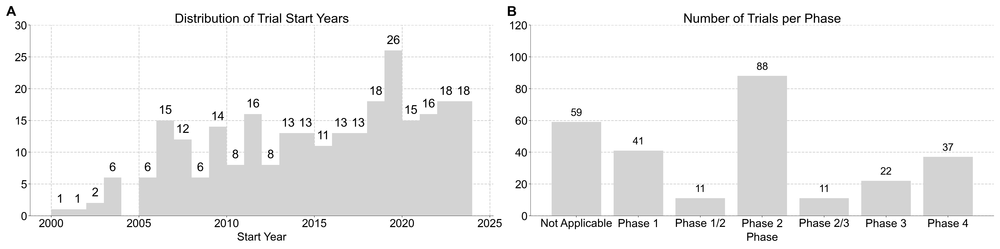

In [280]:
plot_trial_distributions(
    selected_trials_parkinsonism_cluster_right,
    start_year_column="start_year",
    phase_column="phase",
    plot_file_suffix="cluster_right",
)

In [281]:
selected_trials_parkinsonism_cluster_right[
    selected_trials_parkinsonism_cluster_right["phase"] == "Not Applicable"
].sample(n=10)

,Unnamed: 0,nct_id,combined_union_snomed_term_canonical_interventions,combined_union_top_concept_canonical_first_conditions,brief_title,start_date,study_official_title,brief_summary_description,phase,overall_status,start_year,trial_title_summary,cluster
11843,12486,NCT03004573,Levodopa,Bradykinesia |Parkinsonism,Role of Deep Brain Stimulation on Social Cogni...,2017-03-14,Functioning of the Mirror Neurons System in Pa...,Parkinson's disease (PD) is usually responsibl...,Not Applicable,Completed,2017.0,Role of Deep Brain Stimulation on Social Cogni...,Parkinsonism
18559,19466,NCT06214377,Substance with dopamine receptor antagonist me...,Bradykinesia |Pain |Parkinsonism,Transcranial Direct Current Stimulation for Tr...,2023-07-01,Effects of Transcranial Direct Current Stimula...,Parkinson's Disease (PD) is a neurodegenerativ...,Not Applicable,Recruiting,2023.0,Transcranial Direct Current Stimulation for Tr...,Parkinsonism
15631,16289,NCT04648150,Substance with receptor agonist mechanism of a...,Bradykinesia |Pain |Parkinsonism,Evaluation of a Millimeter Wave Emission Brace...,2021-05-18,Evaluation of a Millimeter Wave Emission Brace...,Idiopathic Parkinson's disease is a common neu...,Not Applicable,Completed,2021.0,Evaluation of a Millimeter Wave Emission Brace...,Parkinsonism
4934,5505,NCT00906763,Theobroma cacao,Bradykinesia |Parkinsonism |Depressive conditions,Effects of Chocolate on Motor Symptoms of Park...,2009-05-31,Effects of Chocolate on Motor Symptoms of Park...,Chocolate consumption has long been associated...,Not Applicable,Unknown status,2009.0,Effects of Chocolate on Motor Symptoms of Park...,Parkinsonism
14138,14787,NCT03970239,positron emission tomography using [11 carbon]...,Bradykinesia |Impulse control disorder |Parkin...,Serotonin in Impulse Control Disorders in Park...,2019-05-13,Role of the Serotoninergic System in Impulse C...,Impulse control disorders are frequent and tro...,Not Applicable,Unknown status,2019.0,Serotonin in Impulse Control Disorders in Park...,Parkinsonism
15153,15807,NCT04428983,erinacine a|hericium erinaceus mycelium,Bradykinesia |Parkinsonism |mptp|non-motor sym...,The Effect of Hericium Erinaceus Mycelium in N...,2020-02-03,The Effect of Hericium Erinaceus Mycelium in N...,Parkinson disease (PD) is considered a multisy...,Not Applicable,Unknown status,2020.0,The Effect of Hericium Erinaceus Mycelium in N...,Parkinsonism
15253,15908,NCT04477161,Ketone |ketone ester elite endurance nutrition...,Bradykinesia |Parkinsonism |mitochondrial dysf...,Effect of Ketone Esters in Parkinson's Disease,2019-09-05,Effect of Ketone Esters on Parkinson Disease: ...,Ketones esters have shown to improve mitochond...,Not Applicable,Completed,2019.0,Effect of Ketone Esters in Parkinson's Disease...,Parkinsonism
15034,15686,NCT04370665,cerezyme®,Bradykinesia |Parkinsonism,Blood-Brain-Barrier Disruption With Cerezyme i...,2020-07-16,A Pilot Study for Brain Delivery of Cerezyme® ...,This clinical trial focus on the delivery of C...,Not Applicable,"Active, not recruiting",2020.0,Blood-Brain-Barrier Disruption With Cerezyme i...,Parkinsonism
3861,4417,NCT00669461,Lubiprostone,Bradykinesia |Constipation |Parkinsonism |dela...,Lubiprostone as a Treatment for Constipation i...,2009-06-30,Lubiprostone as a Treatment for Constipation i...,Delayed colonic transient time secondary to a ...,Not Applicable,Terminated,2009.0,Lubiprostone as a Treatment for Constipation i...,Parkinsonism
13408,14055,NCT03665493,Levodopa |pd patients h&y=1.5-2 medications of...,Bradykinesia |Parkinsonism |early-stage|modera...,Dopamine Effect on Inhibitory Control,2020-09-30,Dopamine Effect on Inhibitory Control,The effect of Levodopa medication on inhibitor...,Not Applicable,Completed,2020.0,Dopamine Effect on Inhibitory Control | Dopami...,Parkinsonism


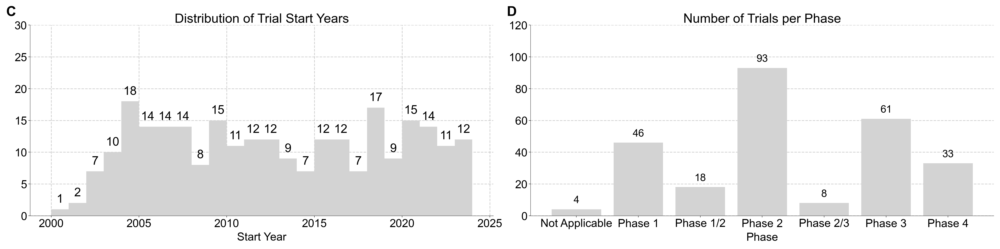

In [282]:
plot_trial_distributions(
    selected_trials_parkinsonism_cluster_left,
    start_year_column="start_year",
    phase_column="phase",
    plot_file_suffix="cluster_left",
    letter_left="C",
    letter_right="D",
)

In [283]:
# Function to format long intervention names with new line after every 4 words
def format_long_name(name, max_words=5):
    if isinstance(name, float):
        return ""  # Handle NaN values
    words = name.split()
    if len(words) > max_words:
        return "\n".join(
            [
                " ".join(words[i : i + max_words])
                for i in range(0, len(words), max_words)
            ]
        )
    return name


def analyze_and_plot_interventions_conditions(
    df,
    interventions_column,
    conditions_column,
    plot_file_suffix="cluster_1",
    letter_left="A",
    letter_right="B",
):
    """
    Analyze and plot the top 20 interventions and conditions from a DataFrame.

    Parameters:
    - df: A pandas DataFrame containing trial data.
    - interventions_column: The column name for concatenated intervention data.
    - conditions_column: The column name for concatenated condition data.

    Returns:
    - A tuple with the number of unique interventions and conditions.
    """
    # Splitting the concatenated values into lists
    df["interventions_list"] = (
        df[interventions_column]
        .str.split("|")
        .apply(lambda x: [item.strip() for item in x])
    )
    df["conditions_list"] = (
        df[conditions_column]
        .str.split("|")
        .apply(lambda x: [item.strip() for item in x])
    )

    # Explode the lists and drop empty strings or NaN values
    interventions_exploded = (
        df["interventions_list"].explode().dropna().replace("", None).dropna()
    )
    conditions_exploded = (
        df["conditions_list"].explode().dropna().replace("", None).dropna()
    )

    # Counting the occurrences of each intervention and condition
    intervention_counts = interventions_exploded.value_counts()
    condition_counts = conditions_exploded.value_counts()

    # Counting unique interventions and conditions
    unique_interventions_count = len(set(interventions_exploded))
    unique_conditions_count = len(set(conditions_exploded))

    # Get the top 20 interventions and conditions
    top_20_interventions = intervention_counts.head(20)
    top_20_conditions = condition_counts.head(20)

    # Apply the format_long_name function to the intervention and condition names
    top_20_interventions.index = top_20_interventions.index.map(
        format_long_name
    )
    top_20_conditions.index = top_20_conditions.index.map(format_long_name)

    # Prepare the figure and two subplots
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 4))

    # Plot for the top 20 condition counts (First plot)
    axes[0].barh(
        top_20_conditions.index,
        top_20_conditions.values,
        color="#DDCC77",
        zorder=3,
    )
    axes[0].set_title("Top 20 Conditions", fontsize=9)
    axes[0].set_xlabel("Count", fontsize=9)
    axes[0].invert_yaxis()  # To have the highest values at the top
    axes[0].grid(axis="x", linestyle="--", alpha=0.6, zorder=1)

    axes[0].text(
        -0.03,
        1.05,
        letter_left,
        transform=axes[0].transAxes,
        fontsize=9,
        fontweight="bold",
        va="top",
        ha="right",
    )
    axes[0].tick_params(axis="both", which="major", labelsize=7.5)

    # Add count labels at the end of the bars for conditions
    for i in range(len(top_20_conditions)):
        axes[0].text(
            top_20_conditions.values[i],
            i,
            str(top_20_conditions.values[i]),
            va="center",
            fontsize=8,
        )

    # Plot for the top 20 intervention counts (Second plot)
    axes[1].barh(
        top_20_interventions.index,
        top_20_interventions.values,
        color="#44AA99",
        zorder=3,
    )
    axes[1].set_title("Top 20 Interventions", fontsize=9)
    axes[1].set_xlabel("Count", fontsize=9)
    axes[1].invert_yaxis()  # To have the highest values at the top
    axes[1].grid(axis="x", linestyle="--", alpha=0.6, zorder=1)

    # Add count labels at the end of the bars for interventions
    for i in range(len(top_20_interventions)):
        axes[1].text(
            top_20_interventions.values[i],
            i,
            str(top_20_interventions.values[i]),
            va="center",
            fontsize=8,
        )

    axes[1].text(
        -0.03,
        1.05,
        letter_right,
        transform=axes[1].transAxes,
        fontsize=9,
        fontweight="bold",
        va="top",
        ha="right",
    )
    axes[1].tick_params(axis="both", which="major", labelsize=7.5)

    # Adjust layout to avoid overlap
    plt.tight_layout()
    plt.savefig(
        f"viz/embeddings/parkinsonism_clusters/trial_distributions_interventions_conditions_{plot_file_suffix}.pdf"
    )
    # Display the plots
    plt.show()

    return unique_interventions_count, unique_conditions_count

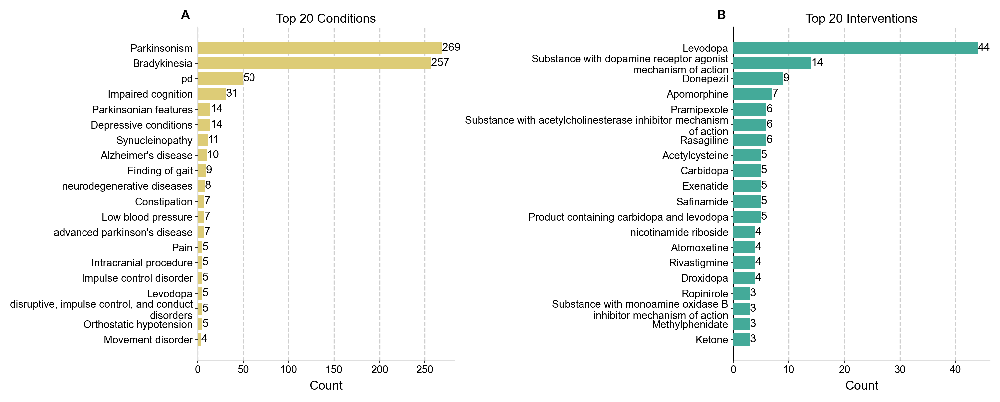

(389, 239)

In [284]:
unique_drugs, unique_diseases = analyze_and_plot_interventions_conditions(
    selected_trials_parkinsonism_cluster_right,
    "combined_union_snomed_term_canonical_interventions",
    "combined_union_top_concept_canonical_first_conditions",
    plot_file_suffix="cluster_right",
)
unique_drugs, unique_diseases

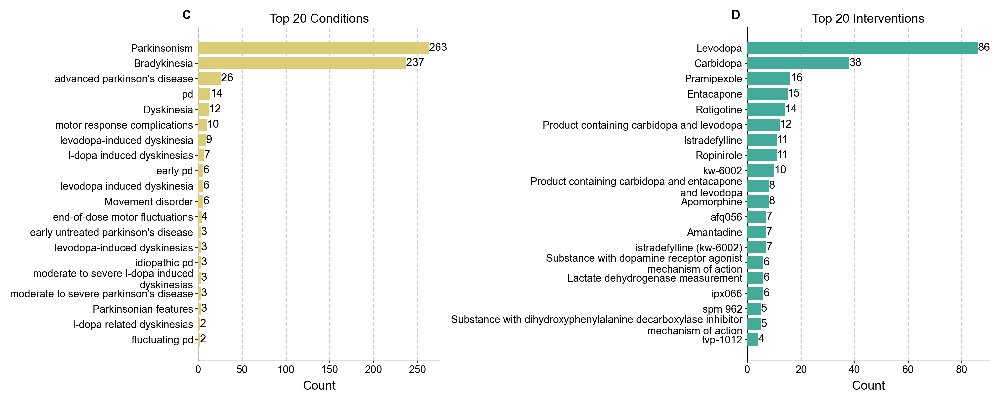

(375, 139)

In [285]:
unique_drugs, unique_diseases = analyze_and_plot_interventions_conditions(
    selected_trials_parkinsonism_cluster_left,
    "combined_union_snomed_term_canonical_interventions",
    "combined_union_top_concept_canonical_first_conditions",
    plot_file_suffix="cluster_left",
    letter_left="C",
    letter_right="D",
)
unique_drugs, unique_diseases

#### check unlabeled trials

In [287]:
# Filter the DataFrame to keep only rows where "cluster" is "unlabeled"
unlabeled_df = df[df["cluster"] == "unlabeled"]

# Get the indices of the filtered DataFrame
unlabeled_indices = unlabeled_df.index

# Use the indices to filter the t-SNE coordinates
unlabeled_tsne = tsne[unlabeled_indices, :]

In [288]:
unlabeled_tsne.shape

(3431, 2)

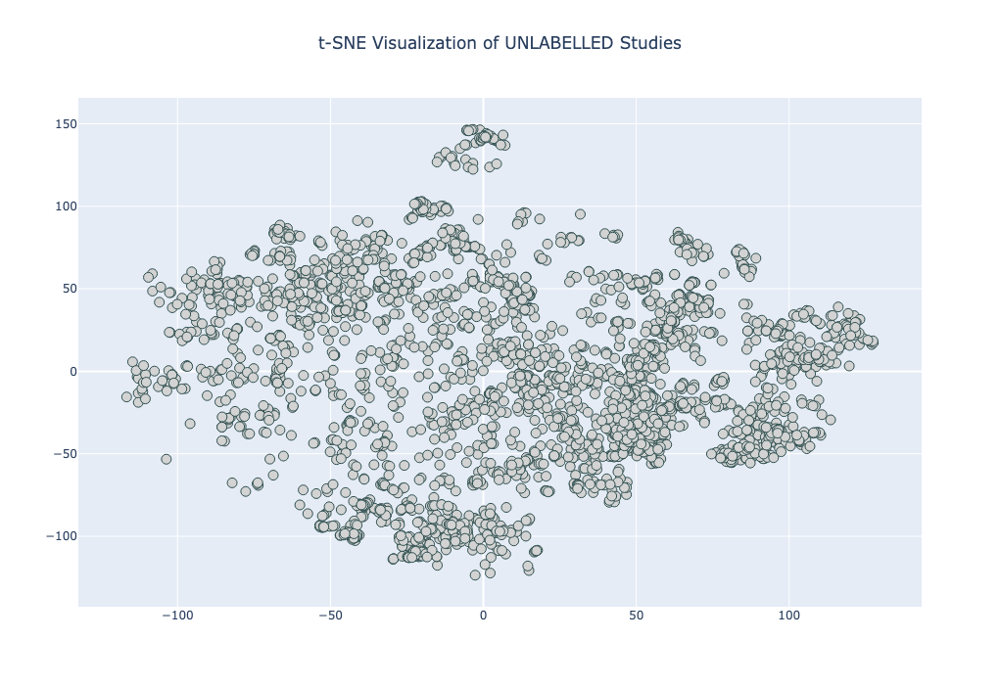

In [289]:
import plotly.graph_objects as go

# Assuming your t-SNE data is stored in a variable named `tsne`
# And your DataFrame `df` contains a column 'study_official_title' for the official titles

fig = go.Figure()

# Add scatter plot for t-SNE data points
fig.add_trace(
    go.Scatter(
        x=unlabeled_tsne[:, 0],  # Use your t-SNE x coordinates
        y=unlabeled_tsne[:, 1],  # Use your t-SNE y coordinates
        mode="markers",
        marker=dict(
            color="LightGrey",  # Use a single color for all points
            size=10,  # Adjust the marker size here
            line=dict(width=1, color="DarkSlateGrey"),
        ),
        hovertemplate="<b>Title:</b> %{text}",
        text=unlabeled_df[
            "study_official_title"
        ],  # Make sure this points to the column with your official titles
        showlegend=False,  # Hide the legend for data points
    )
)

# Update plot size here
fig.update_layout(
    title="t-SNE Visualization of UNLABELLED Studies",
    title_x=0.5,
    width=900,  # Set the width of the plot
    height=700,  # Set the height of the plot
)
# Show the figure
fig.show()

## Drugs

In [291]:
top_30_drug_names = [
    "Risperidone",
    "Levodopa",
    "Anti-psychotic agent",
    "Ketamine",
    "Olanzapine",
    "Aripiprazole",
    "Carbidopa",
    "Dexmedetomidine",
    "Quetiapine",
    "Donepezil",
    "Nicotine",
    "serotonin re-uptake inhibitor",
    "Clostridium botulinum toxin",
    "Botulinum toxin type A",
    "Propofol",
    "Lidocaine",
    "Escitalopram",
    "Pregabalin",
    "Memantine",
    "Nicotine resin complex",
    "Levetiracetam",
    "Bupropion",
    "Cannabidiol",
    "Valproic acid",
    "Topiramate",
    "Melatonin",
    "Aspirin",
    "Oxytocin",
    "Lithium",
    "N-3 fatty acid",
    "vaccine",
]

In [292]:
top_30_drug_names = [
    "Risperidone",
    "Levodopa",
    "Ketamine",
    "Olanzapine",
    "Aripiprazole",
    "Dexmedetomidine",
    "Quetiapine",
    "Anti-psychotic agent",
    "Donepezil",
    "Nicotine",
    "Clostridium botulinum toxin",
    "vaccine",
    "Lidocaine",
    "Escitalopram",
    "Propofol",
    "Pregabalin",
    "Memantine",
    "Levetiracetam",
    "Valproic acid",
    "Cannabidiol",
    "Aspirin",
    "Oxytocin",
    "Lithium",
    "Melatonin",
    "Topiramate",
    "Varenicline",
    "N-3 fatty acid",
    "Bupropion",
    "Sertraline",
    "Steroid",
]

In [293]:
colors_new_legend = dict(zip(top_30_drug_names, chosen_colors))
len(colors_new_legend)

30

In [294]:
df

,Unnamed: 0,nct_id,combined_union_snomed_term_canonical_interventions,combined_union_top_concept_canonical_first_conditions,brief_title,start_date,study_official_title,brief_summary_description,phase,overall_status,start_year,trial_title_summary,cluster
0,89,NCT00000307,Naltrexone,Disorder caused by alcohol |Disorder caused by...,Naltrexone as Adjunct in Alcoholic Cocaine Dep...,2003-04-30,Naltrexone as an Adjunct in Alcoholic Cocaine ...,The purpose of this study is to evaluate naltr...,Phase 2,Completed,2003.0,Naltrexone as Adjunct in Alcoholic Cocaine Dep...,Disorder caused by cocaine
1,106,NCT00000333,Atropine |Benzatropine |Substance with dopamin...,Cocaine|Disorder caused by cocaine,Evaluation of Benztropine for Cocaine Craving - 2,2001-05-31,Evaluation of Efficacy of Benztropine for Coca...,The purpose of this study is to compare the ef...,Phase 2,Completed,2001.0,Evaluation of Benztropine for Cocaine Craving ...,Disorder caused by cocaine
2,145,NCT00000428,Amitriptyline |Fluoxetine |amitriptyline plus ...,Fibromyalgia |Pain,Combining N-of-1 Trials to Assess Fibromyalgia...,2000-09-30,Combining N-of-1 Trials to Assess Fibromyalgia...,This study will compare the effectiveness of c...,Phase 4,Completed,2000.0,Combining N-of-1 Trials to Assess Fibromyalgia...,Pain
3,146,NCT00000439,Sodium valproate |Valproate |Valproic acid |de...,Bipolar disorder |Co-morbid conditions |Disord...,Drug Treatment for Alcoholics With Bipolar Dis...,2000-10-31,Efficacy of Valproate Maintenance in Bipolar A...,The purpose of this study is to test the effec...,Phase 2,Completed,2000.0,Drug Treatment for Alcoholics With Bipolar Dis...,Bipolar disorder
4,220,NCT00001956,Ketorolac |Lidocaine |Midazolam |Sedative,Hyperalgesia |Pain |Removal |Surgical procedure,Influence of Genetics in Pain Sensitivity,2000-01-31,NaN,The purpose of this study is to learn more abo...,Phase 2,Completed,2000.0,Influence of Genetics in Pain Sensitivity | |...,Surgical procedure
...,...,...,...,...,...,...,...,...,...,...,...,...,...
18604,19606,NCT06282640,Ergocalciferol |Vitamin D measurement |v,Median neuropathy |Pain |Peripheral nerve dise...,Comparıson Of Electromyography Results Before ...,2021-12-30,Comparıson Of Electromyography Results Before ...,"Therefore, we aimed to evaluate the effectiven...",Phase 4,Completed,2021.0,Comparıson Of Electromyography Results Before ...,Pain
18605,19613,NCT06287502,2-methyl-3-hydroxybutyrate,Degenerative disorder of muscle |Osteoporosis ...,Efficacy of Structured Exercise-Nutritional In...,2022-09-09,Efficacy of Structured Exercise-Nutritional In...,"This is a prospective parallel group, double-b...",Not Applicable,"Active, not recruiting",2022.0,Efficacy of Structured Exercise-Nutritional In...,unlabeled
18606,19616,NCT06289335,Dexmedetomidine |Ondansetron,Procedure on abdomen |emergence delirium|post-...,Dexmedetomidine Compared to Ondansetron for Po...,2020-08-05,Dexmedetomidine Compared With Ondansetron in T...,Evaluate the efficiency of management with int...,Phase 2,Completed,2020.0,Dexmedetomidine Compared to Ondansetron for Po...,unlabeled
18607,19623,NCT06292351,dmb-i|dmb-i (dimebon),Alzheimer's disease |Impaired cognition,DMB-I in the Treatment of Alzheimer Type Dementia,2023-12-27,Multicenter Randomized Double-blind Placebo-co...,The purpose of this study is to assess the eff...,Phase 2/3,Recruiting,2023.0,DMB-I in the Treatment of Alzheimer Type Demen...,Alzheimer's disease


In [295]:
%%time
labels_new, colors_new = improved_coloring(
    df["combined_union_snomed_term_canonical_interventions"],
    colors_new_legend,
)

df["cluster"] = labels_new

CPU times: user 280 ms, sys: 7.64 ms, total: 288 ms
Wall time: 289 ms


In [296]:
cluster_sizes = df["cluster"].value_counts()

# Optionally, to convert it back to a DataFrame for better visualization or further processing:
cluster_sizes_df = cluster_sizes.reset_index().rename(
    columns={"index": "Cluster", "cluster": "Size"}
)

print(cluster_sizes_df)

                           Size  count
0                     unlabeled  13964
1                       vaccine    429
2                      Levodopa    287
3                      Ketamine    213
4          Anti-psychotic agent    185
5                  Aripiprazole    176
6                   Risperidone    170
7               Dexmedetomidine    169
8                    Olanzapine    160
9                      Nicotine    159
10                   Quetiapine    158
11  Clostridium botulinum toxin    154
12                    Donepezil    153
13                     Propofol    145
14                    Lidocaine    140
15                   Pregabalin    135
16                    Memantine    135
17                 Escitalopram    128
18                  Cannabidiol    128
19                     Oxytocin    125
20                      Lithium    124
21                Levetiracetam    123
22                      Aspirin    123
23                    Bupropion    122
24                    Mel

/Users/sdoneva/Documents/Work/In Progress/PhD/PhD Projects/In Progress/NeuroTrialAnalysis/src/plotting.py:442: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

/Users/sdoneva/Documents/Work/In Progress/PhD/PhD Projects/In Progress/NeuroTrialAnalysis/src/plotting.py:438: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`

/Users/sdoneva/Documents/Work/In Progress/PhD/PhD Projects/In Progress/NeuroTrialAnalysis/src/plotting.py:458: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value

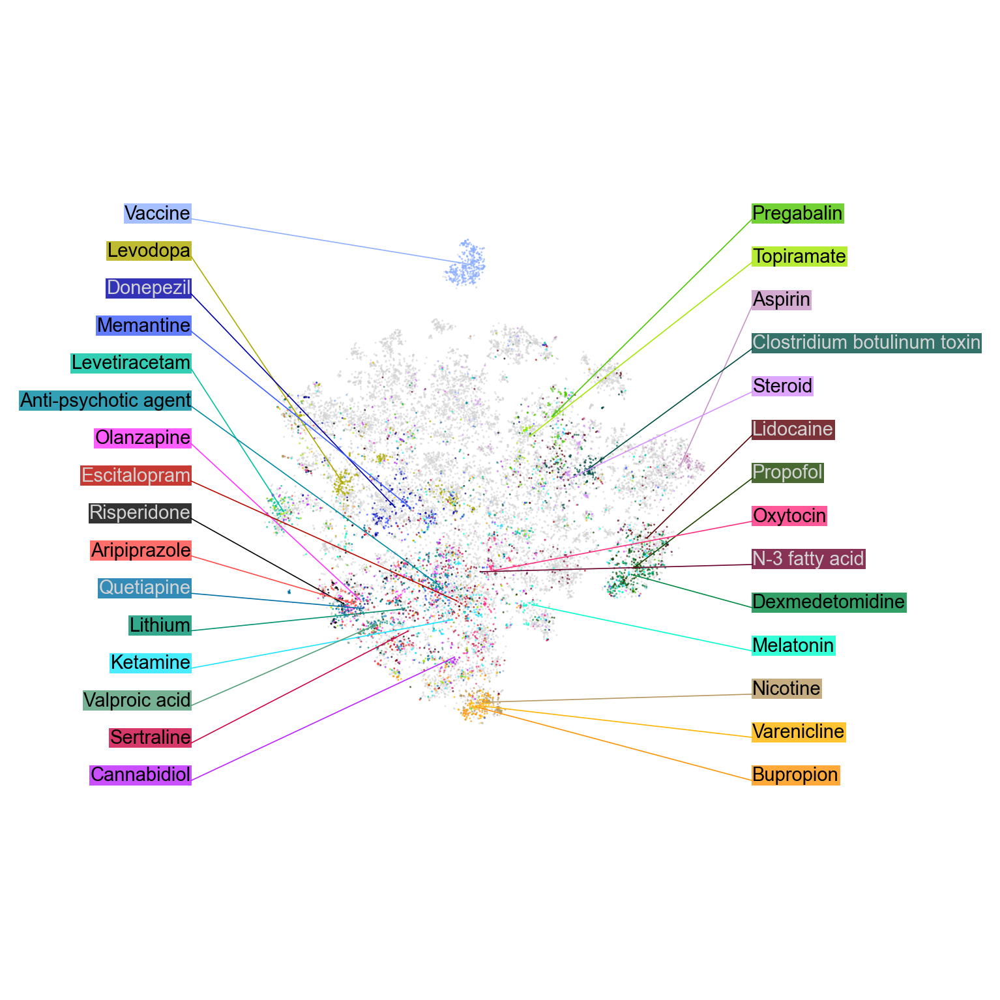

In [297]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5, 5), dpi=300, layout="constrained")

txtkwargs = dict(size=8, weight="bold", va="top", ha="left")
x_lim = (-160, 160)
y_lim = (-160, 160)

plot_tsne_colors(
    tsne, colors_new, x_lim=x_lim, y_lim=y_lim, ax=ax, plot_type="test"
)
plot_label_tags(
    tsne,
    colors_new,
    colors_new_legend,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    fontsize=7,
    rs=2,
    subset=False,
)

fig.savefig(
    figures_path
    / f"tsne_colored_by_drug_labels_{len(tsne)}_with_cdist_threshold.pdf",
    dpi=300,
)

In [115]:
# Filter the DataFrame to keep only rows where "cluster" is "unlabeled"
unlabeled_df = df[df["cluster"] == "unlabeled"]

# Get the indices of the filtered DataFrame
unlabeled_indices = unlabeled_df.index

# Use the indices to filter the t-SNE coordinates
unlabeled_tsne = tsne[unlabeled_indices, :]

unlabeled_tsne.shape

(13964, 2)

In [118]:
counts = unlabeled_df[intervention_col].value_counts()
counts = counts.sort_values(ascending=False).head(30)
counts

combined_union_snomed_term_canonical_interventions
Acetylcysteine (substance)                                                                 57
Antidepressant (substance)                                                                 43
Minocycline (substance)                                                                    32
Metformin (substance)                                                                      31
Cycloserine (substance)                                                                    31
Duloxetine (substance)                                                                     29
Methylphenidate (substance)                                                                28
Fluoxetine (substance)                                                                     27
Lamotrigine (substance)                                                                    27
Gabapentin (substance)                                                                     27
Modafinil

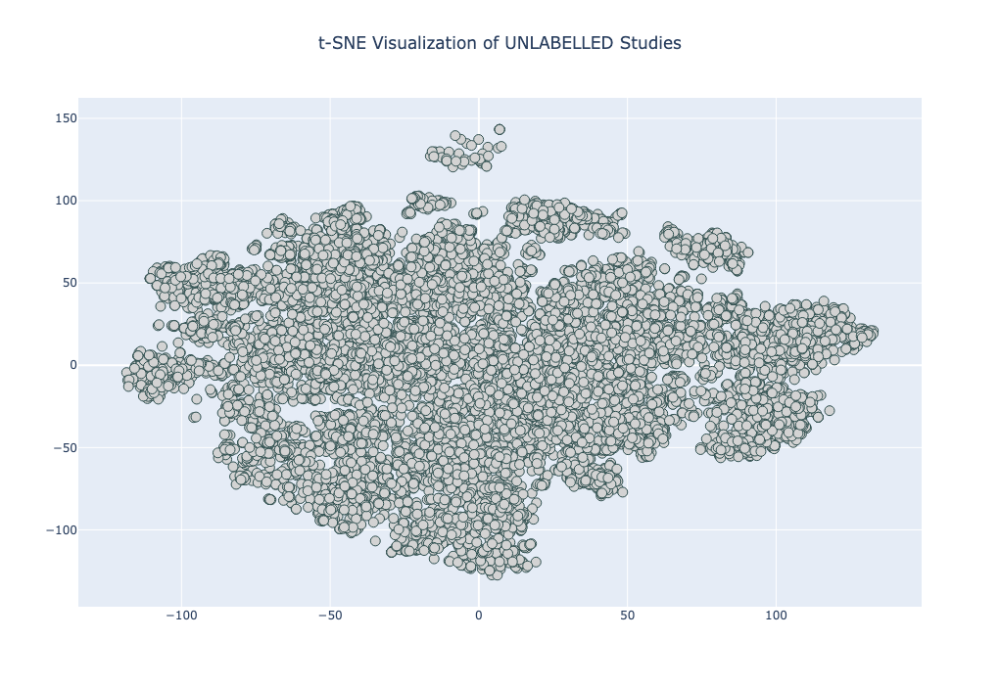

In [120]:
import plotly.graph_objects as go

# Assuming your t-SNE data is stored in a variable named `tsne`
# And your DataFrame `df` contains a column 'study_official_title' for the official titles

fig = go.Figure()

# Add scatter plot for t-SNE data points
fig.add_trace(
    go.Scatter(
        x=unlabeled_tsne[:, 0],  # Use your t-SNE x coordinates
        y=unlabeled_tsne[:, 1],  # Use your t-SNE y coordinates
        mode="markers",
        marker=dict(
            color="LightGrey",  # Use a single color for all points
            size=10,  # Adjust the marker size here
            line=dict(width=1, color="DarkSlateGrey"),
        ),
        hovertemplate="<b>Title:</b> %{text}",
        text=unlabeled_df[
            "study_official_title"
        ],  # Make sure this points to the column with your official titles
        showlegend=False,  # Hide the legend for data points
    )
)

# Update plot size here
fig.update_layout(
    title="t-SNE Visualization of UNLABELLED Studies",
    title_x=0.5,
    width=900,  # Set the width of the plot
    height=700,  # Set the height of the plot
)
# Show the figure
fig.show()

## Colors by Year

In [122]:
aact_data_years = df[["nct_id", "start_date"]].drop_duplicates()
aact_data_years["start_date"] = pd.to_datetime(aact_data_years["start_date"])
# Extract year component and create new columns
aact_data_years["start_year"] = aact_data_years["start_date"].dt.year
aact_data_years

,nct_id,start_date,start_year
0,NCT00000307,2003-04-30,2003
1,NCT00000333,2001-05-31,2001
2,NCT00000428,2000-09-30,2000
3,NCT00000439,2000-10-31,2000
4,NCT00001956,2000-01-31,2000
...,...,...,...
18604,NCT06282640,2021-12-30,2021
18605,NCT06287502,2022-09-09,2022
18606,NCT06289335,2020-08-05,2020
18607,NCT06292351,2023-12-27,2023


In [123]:
years = list(set(aact_data_years["start_year"].dropna()))
years

[2000,
 2001,
 2002,
 2003,
 2004,
 2005,
 2006,
 2007,
 2008,
 2009,
 2010,
 2011,
 2012,
 2013,
 2014,
 2015,
 2016,
 2017,
 2018,
 2019,
 2020,
 2021,
 2022,
 2023]

In [127]:
min(years)

2000

In [129]:
min_year = min(years)  # 1970
length_interval = 2022 - min_year
cmap_values = np.linspace(0, 1, length_interval + 1)
year_numbers_list = np.arange(min_year, 2023).tolist()

dicc_years = dict(zip(year_numbers_list, cmap_values))

In [131]:
years_out = [year for year in range(1808, min_year)] + [
    year for year in range(2024, 2100)
]

for elem in years_out:
    dicc_years[elem] = 0

In [132]:
aact_data_years.shape

(18609, 3)

In [135]:
dates = aact_data_years["start_year"].astype(str)
dic = dicc_years

N = len(years)

dict_colors = {}

date_year = np.zeros(len(dates))

for i in range(N):
    sub1 = str(years[i])
    # print(sub1)
    indexes1 = dates.str.find(sub1)

    non_1_1 = indexes1[indexes1 != -1]

    date_year[indexes1 != -1] = int(years[i])

# create colors
date_colors = np.vectorize(dic.get)(date_year)

In [137]:
colors_per_year_reparsed = date_colors

In [139]:
len(colors_per_year_reparsed)

18609

In [141]:
np.save(variables_path / "colors_per_year_reparsed", colors_per_year_reparsed)
np.save(variables_path / "date_year_reparsed", date_year)

### Plot

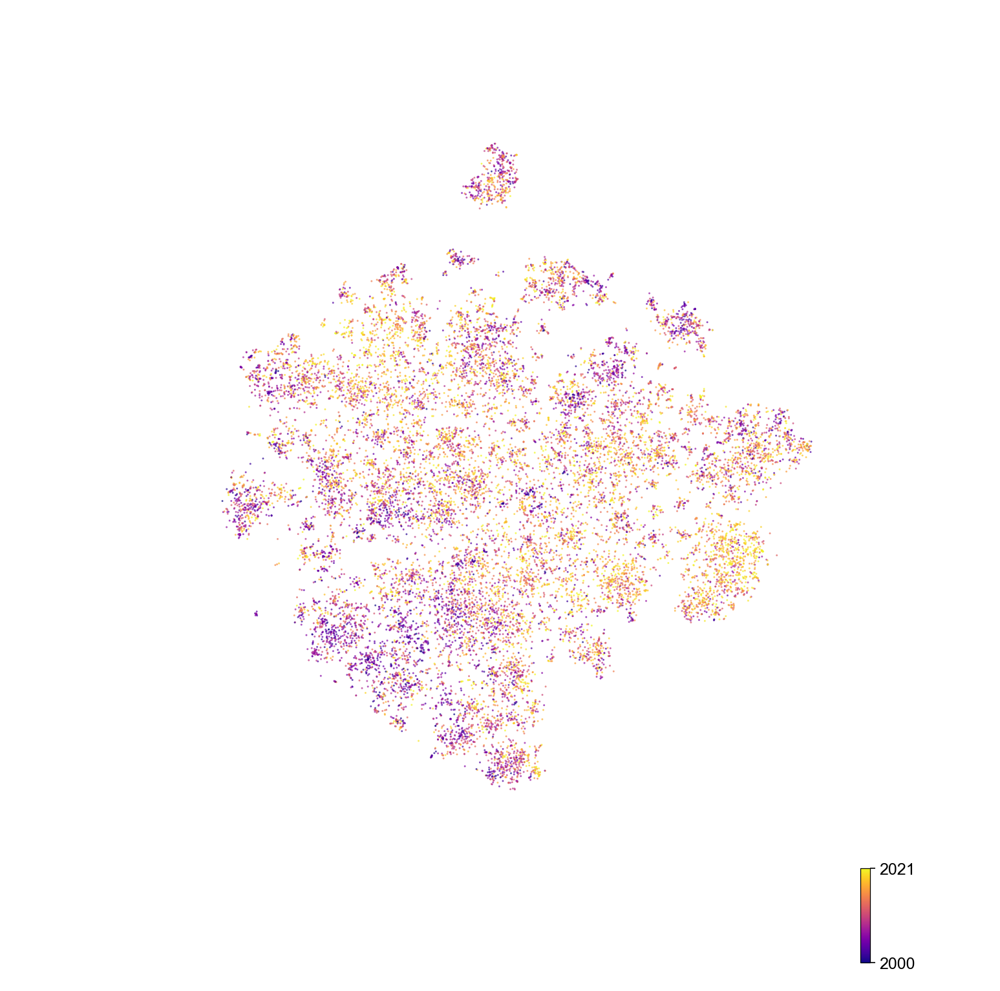

In [144]:
%matplotlib inline

fig, ax = plt.subplots(figsize=(5, 5), dpi=300, layout="constrained")

txtkwargs = dict(size=8, weight="bold", va="top", ha="left")
x_lim = (-230, 230)
y_lim = (-230, 230)

plot_tsne_years(
    tsne,
    colors_per_year_reparsed,
    x_lim=x_lim,
    y_lim=y_lim,
    ax=ax,
    fontsize=6,
    colorbar=True,
    plot_type="test",
    min_year=min_year,
)

## Colors by Phase

In [147]:
aact_data = pd.read_csv(
    "data/raw_aact/combined_neuro_trials_with_interventions_20240412.csv"
)
aact_data_phase = aact_data[["nct_id", "phase"]].drop_duplicates()
aact_data_phase

,nct_id,phase
0,NCT03651726,Phase 2
5,NCT02326883,Not Applicable
14,NCT05262348,Not Applicable
20,NCT01550107,Phase 4
26,NCT04375436,Phase 1
...,...,...
503980,NCT02422303,Not Applicable
503983,NCT02714049,Phase 4
503987,NCT04408573,Not Applicable
503990,NCT03869463,Not Applicable


In [148]:
df_with_phase = df.merge(aact_data_phase, on="nct_id", how="left")
df_phases = df_with_phase[["phase"]]

KeyError: "None of [Index(['phase'], dtype='object')] are in the [columns]"

In [ ]:
df_phases.shape

In [ ]:
cluster_sizes = df_with_phase["phase"].value_counts()
cluster_sizes

In [ ]:
df_tsne = pd.DataFrame(tsne, columns=["x", "y"])

# Ensure the DataFrame with your phase data is aligned in row order with your t-SNE data
# Assuming it is already correctly aligned and has the same index

# Concatenate the t-SNE DataFrame with the phase DataFrame along the axis 1 (columns)
df_tsne_phase = pd.concat([df_tsne, df_phases], axis=1)

# Plot using matplotlib, coloring by phase
plt.figure(figsize=(4, 4))
for phase in df_tsne_phase["phase"].unique():
    subset = df_tsne_phase[df_tsne_phase["phase"] == phase]
    plt.scatter(subset["x"], subset["y"], label=phase)

plt.title("t-SNE Plot Colored by Phase")
plt.xlabel("Component 1")
plt.ylabel("Component 2")
plt.legend(title="Phase")
plt.tight_layout()

plt.savefig(figures_path / "tsne_colored_by_phase.pdf", dpi=300)
plt.savefig(figures_path / "tsne_colored_by_phase.png", dpi=300)

plt.show()